# Data Analyst Project : Amazon Product Price & Ratings

## Objective
- Find out which type of products is the most popular
- Does the discount help the sales of the product?
- What price range does people buy the most?

## Importing Packages

In [1]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import opendatasets as od
import os
import kaggle
import zipfile
import glob
import plotly.express as px

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

init_notebook_mode(connected=True)

import cufflinks as cf
cf.go_offline()

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline


In [3]:
pd.options.display.float_format = '{:.2f}'.format

## Gathering the Data

In [4]:
# getting the files from kaggle, only need to run once
#od.download('https://www.kaggle.com/datasets/lokeshparab/amazon-products-dataset/data')

In [5]:
#Listing all the csv from my downloads
csv_files = glob.glob(r'/Users/omarbenavente/Downloads/amazon/*csv')

In [6]:
#How many csv files do I have on the file
len(glob.glob(r'/Users/omarbenavente/Downloads/amazon/*csv'))

140

In [7]:
df = pd.concat([pd.read_csv(f,index_col=False) for f in csv_files ])
# using concat to merge all the files since all of the files number of row and category matches

In [8]:
df.head()
# checking the top 5 of the dataset

,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price,actual_price,Unnamed: 0
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71C5GfgxW2...,https://www.amazon.in/Skybags-Treble-FIFA-Prin...,4.5,2,"₹7,250","₹14,500",NaN
1,Tommy Hilfiger Plastic Hard 66 cms Luggage (89...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/41lIioNQ3N...,https://www.amazon.in/Tommy-Hilfiger-Luggage-8...,3.6,70,"₹6,399","₹7,999",NaN
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XSVc5fxg...,https://www.amazon.in/Samsonite-Polyester-Lugg...,4.0,5,"₹12,220","₹18,800",NaN
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51euSZMWAn...,https://www.amazon.in/Skybags-Combo-Polycarbon...,4.4,66,"₹6,648","₹10,043.04",NaN
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/710caoNQ4X...,https://www.amazon.in/Skybags-Printed-Polycarb...,4.3,5,"₹6,850","₹17,400",NaN


## Cleaning the Data

In [9]:
# rechecking our dataframe
df.head()

,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price,actual_price,Unnamed: 0
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71C5GfgxW2...,https://www.amazon.in/Skybags-Treble-FIFA-Prin...,4.5,2,"₹7,250","₹14,500",NaN
1,Tommy Hilfiger Plastic Hard 66 cms Luggage (89...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/41lIioNQ3N...,https://www.amazon.in/Tommy-Hilfiger-Luggage-8...,3.6,70,"₹6,399","₹7,999",NaN
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XSVc5fxg...,https://www.amazon.in/Samsonite-Polyester-Lugg...,4.0,5,"₹12,220","₹18,800",NaN
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51euSZMWAn...,https://www.amazon.in/Skybags-Combo-Polycarbon...,4.4,66,"₹6,648","₹10,043.04",NaN
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/710caoNQ4X...,https://www.amazon.in/Skybags-Printed-Polycarb...,4.3,5,"₹6,850","₹17,400",NaN


In [10]:
df.info()
# checking for columns, and their data type

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1103170 entries, 0 to 1103
Data columns (total 10 columns):
 #   Column          Non-Null Count    Dtype  
---  ------          --------------    -----  
 0   name            1103170 non-null  object 
 1   main_category   1103170 non-null  object 
 2   sub_category    1103170 non-null  object 
 3   image           1103170 non-null  object 
 4   link            1103170 non-null  object 
 5   ratings         751582 non-null   object 
 6   no_of_ratings   751582 non-null   object 
 7   discount_price  980844 non-null   object 
 8   actual_price    1067544 non-null  object 
 9   Unnamed: 0      551585 non-null   float64
dtypes: float64(1), object(9)
memory usage: 92.6+ MB


In [11]:
#checking the number of rows and columns
df.shape

(1103170, 10)

In [12]:
#ouputting the column names
df.columns

Index(['name', 'main_category', 'sub_category', 'image', 'link', 'ratings',
       'no_of_ratings', 'discount_price', 'actual_price', 'Unnamed: 0'],
      dtype='object')

In [13]:
# Since the column 'Unamed: 0' is a useless column, it's better to remove it
df = df[['name', 'main_category', 'sub_category', 'image', 'link', 'ratings',
       'no_of_ratings', 'discount_price', 'actual_price']]

In [14]:
df.head()

,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price,actual_price
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71C5GfgxW2...,https://www.amazon.in/Skybags-Treble-FIFA-Prin...,4.5,2,"₹7,250","₹14,500"
1,Tommy Hilfiger Plastic Hard 66 cms Luggage (89...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/41lIioNQ3N...,https://www.amazon.in/Tommy-Hilfiger-Luggage-8...,3.6,70,"₹6,399","₹7,999"
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XSVc5fxg...,https://www.amazon.in/Samsonite-Polyester-Lugg...,4.0,5,"₹12,220","₹18,800"
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51euSZMWAn...,https://www.amazon.in/Skybags-Combo-Polycarbon...,4.4,66,"₹6,648","₹10,043.04"
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/710caoNQ4X...,https://www.amazon.in/Skybags-Printed-Polycarb...,4.3,5,"₹6,850","₹17,400"


In [15]:
df.duplicated().sum()
# we have a lot of duplicates in this file. we're going to drop all the dupicates

533275

In [16]:
df = df.drop_duplicates()

In [17]:
df.head()

,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price,actual_price
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71C5GfgxW2...,https://www.amazon.in/Skybags-Treble-FIFA-Prin...,4.5,2,"₹7,250","₹14,500"
1,Tommy Hilfiger Plastic Hard 66 cms Luggage (89...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/41lIioNQ3N...,https://www.amazon.in/Tommy-Hilfiger-Luggage-8...,3.6,70,"₹6,399","₹7,999"
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XSVc5fxg...,https://www.amazon.in/Samsonite-Polyester-Lugg...,4.0,5,"₹12,220","₹18,800"
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51euSZMWAn...,https://www.amazon.in/Skybags-Combo-Polycarbon...,4.4,66,"₹6,648","₹10,043.04"
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/710caoNQ4X...,https://www.amazon.in/Skybags-Printed-Polycarb...,4.3,5,"₹6,850","₹17,400"


In [18]:
df.shape
# we pretty much remove almost 50% of the data. 

(569895, 9)

- Dealing with nulls

In [19]:
df['discount_price'].unique()

array(['₹7,250', '₹6,399', '₹12,220', ..., '₹318.79', '₹988.57',
       '₹397.75'], dtype=object)

In [20]:
# removing ₹(rupee) and comma, then converting it to a float. As well as converting to rupees to $USD
df['discount_price'] = round(df['discount_price'].str.replace('₹','').str.replace(',','').astype('float64')*0.012,2) 

In [21]:
# removing ₹(rupee) and comma, then converting it to a float. As well as converting to rupees to $USD
df['actual_price'] = round(df['actual_price'].str.replace('₹','').str.replace(',','').astype('float64')*0.012,2)

We have removed all the string values and converted to a float number of the price columns. Now we need to convert rating to a float as well

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 569895 entries, 0 to 43
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   name            569895 non-null  object 
 1   main_category   569895 non-null  object 
 2   sub_category    569895 non-null  object 
 3   image           569895 non-null  object 
 4   link            569895 non-null  object 
 5   ratings         394101 non-null  object 
 6   no_of_ratings   394101 non-null  object 
 7   discount_price  507701 non-null  float64
 8   actual_price    551821 non-null  float64
dtypes: float64(2), object(7)
memory usage: 43.5+ MB


In [23]:
# using the unique fuction to see if theres any value that is not a number.
df['ratings'].unique()

array(['4.5', '3.6', '4.0', '4.4', '4.3', nan, '2.8', '3.4', '4.2', '3.7',
       '4.1', '3.9', '4.6', '3.8', 'FREE', '1.0', '3.2', '5.0', '2.5',
       '4.7', '3.3', '3.0', '2.3', '3.5', '1.5', '3.1', '2.9', '2.0',
       '2.6', '2.4', '2.2', '2.7', '4.9', '2.1', '4.8', 'Get', '1.8',
       '1.4', '1.3', 3.9, 4.1, 4.0, 5.0, 3.6, 3.8, 3.7, 4.9, 4.4, 2.8,
       3.5, 4.3, 4.2, 4.7, 3.3, 4.5, 3.4, 4.6, 2.9, 3.1, 1.0, 2.0, 3.0,
       4.8, 3.2, 2.6, 1.5, 2.7, 2.4, 2.5, 2.2, 1.9, 2.3, '1.6', '1.9',
       '1.7', '₹70', '1.2', '₹99', '₹2.99', 1.7, 1.6, 1.8, 1.4, 1.3, 2.1,
       '₹68.99', '₹65', '₹100', '1.1'], dtype=object)

In [24]:
# we have a couple of values that is different from the ratings. I'm going to replace it with the rating 0.
df['ratings'] = df['ratings'].replace(['Get','FREE','₹68.99', '₹65','₹70', '₹100', '₹99', '₹2.99'], '0.0').astype('float64')

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 569895 entries, 0 to 43
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   name            569895 non-null  object 
 1   main_category   569895 non-null  object 
 2   sub_category    569895 non-null  object 
 3   image           569895 non-null  object 
 4   link            569895 non-null  object 
 5   ratings         394101 non-null  float64
 6   no_of_ratings   394101 non-null  object 
 7   discount_price  507701 non-null  float64
 8   actual_price    551821 non-null  float64
dtypes: float64(3), object(6)
memory usage: 43.5+ MB


In [26]:
df['no_of_ratings'] = df['no_of_ratings'].astype(str)

In [27]:
df['no_of_ratings'].unique()

array(['2', '70', '5', ..., '4,816', '3,424', '3,569'], dtype=object)

In [28]:
#I want to check all of the non digits of the # of ratings columns
df[df['no_of_ratings'].str.isdigit() == False]

,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price,actual_price
5,OBANI Faux Leather Mini Briefcase Brown. Dimen...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/81MohdDYVP...,https://www.amazon.in/OBANI-Faux-Leather-Brief...,NaN,nan,27.59,43.20
10,VIP Neptune Polycarbonate 8 Wheels Trolley Bag...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/41srt-S1uw...,https://www.amazon.in/VIP-Neptune-Polycarbonat...,NaN,nan,82.80,165.60
15,American Tourister Krypton SP Rol Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51J-MKBzSW...,https://www.amazon.in/American-Tourister-Krypt...,NaN,nan,57.60,115.20
23,LUMA 55/65 4W Printed,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71HREuyPfk...,https://www.amazon.in/LUMA-55-65-4W-Printed/dp...,NaN,nan,60.54,196.32
25,American Tourister Curio Polypropylene Spinner...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XBR6-mAa...,https://www.amazon.in/American-Tourister-Polyp...,NaN,nan,88.79,112.68
...,...,...,...,...,...,...,...,...,...
38,"new balance Women's 005V1 Sneaker, Grey, Size 6.0",stores,Fashion Sales & Deals,https://m.media-amazon.com/images/I/71XuEwrF+l...,https://www.amazon.in/new-balance-Womens-005V1...,5.00,1.0,NaN,129.37
39,new balance Women's Q118 FTWR 6 M US Grey,stores,Fashion Sales & Deals,https://m.media-amazon.com/images/I/71ycD8elvd...,https://www.amazon.in/new-balance-Womens-Q118-...,5.00,1.0,NaN,129.48
40,New Balance Women&#39;s Wrl247ss,stores,Fashion Sales & Deals,https://m.media-amazon.com/images/I/71ycD8elvd...,https://www.amazon.in/new-balance-WRL247SY-Bal...,5.00,1.0,NaN,118.70
41,new balance Women's Q118 FTWR 7 M US Grey,stores,Fashion Sales & Deals,https://m.media-amazon.com/images/I/71ycD8elvd...,https://www.amazon.in/new-balance-Womens-Q118-...,5.00,2.0,NaN,161.90


In [29]:
#outputting the unique non-digit of the column
df['no_of_ratings'][df['no_of_ratings'].str.isdigit() == False].unique()

array(['nan', 'Only 1 left in stock.', '2,855', ..., '4,816', '3,424',
       '3,569'], dtype=object)

### Some of the values have numbers with a comma or a period, we want to use the replace function to get rid of the comma and the period in order to retrieve only the digits

In [30]:
df_copy = df.copy()

In [31]:
# replacing a comma with an empty string
df_copy['no_of_ratings'] = df_copy['no_of_ratings'].str.replace(',','')

In [32]:
# making an integer a float
df_copy['no_of_ratings'] = df_copy['no_of_ratings'].str.replace('.0','')

In [33]:
df_copy['no_of_ratings'][df_copy['no_of_ratings'].str.isdigit() == False].unique()
#Checking if there's any number that needs some cleaning in order to be a digit

array(['', 'nan', 'Only 1 left in stock.', 'Only 2 left in stock.',
       'Usually dispatched in 4 to 5 days.',
       'Usually dispatched in 5 to 6 days.',
       'Usually dispatched in 6 to 7 days.',
       'Usually dispatched in 3 to 4 weeks.',
       'Usually dispatched in 2 to 3 weeks.',
       'Usually dispatched in 4 to 5 weeks.',
       'Usually dispatched in 8 to 9 days.', 'FREE Delivery by Amazon',
       'Only 3 left in stock.', 'Only 5 left in stock.',
       'Usually dispatched in 7 to 8 days.',
       'Usually dispatched in 11 to 12 days.',
       'Usually dispatched in 9 to  days.',
       'Usually dispatched in 3 to 5 days.',
       'Usually dispatched in 2 to 3 days.', 'Only 4 left in stock.',
       'Usually dispatched in 1 to 2 months.',
       'This item will be released on August 14 23.'], dtype=object)

In [34]:
# since the non digits are only nulls and strings, I want to keep the rows that are digits

In [35]:
df_copy = df_copy[df_copy['no_of_ratings'].str.isdigit() == True]

In [36]:
df_copy.head()

,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price,actual_price
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71C5GfgxW2...,https://www.amazon.in/Skybags-Treble-FIFA-Prin...,4.50,2,87.00,174.00
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XSVc5fxg...,https://www.amazon.in/Samsonite-Polyester-Lugg...,4.00,5,146.64,225.60
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51euSZMWAn...,https://www.amazon.in/Skybags-Combo-Polycarbon...,4.40,66,79.78,120.52
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/710caoNQ4X...,https://www.amazon.in/Skybags-Printed-Polycarb...,4.30,5,82.20,208.80
6,"American Tourister Krypton Strolly 69Cm, Red P...",bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/61Q19URNH6...,https://www.amazon.in/American-tourister-Krypt...,2.80,2,69.58,150.00


In [37]:
df_copy.isnull().sum()
# we got rid of the unwanted nulls and strings in the # of ratings columns.
# Now we want the null values for discounted price to be at $0 since the product never recieved a discount.
# I want to drop the row that has null values from the actaul price since the Exploratory data analysis is going to be based on the actual price

name                  0
main_category         0
sub_category          0
image                 0
link                  0
ratings               0
no_of_ratings         0
discount_price    34097
actual_price       6701
dtype: int64

In [38]:
df_copy['no_of_ratings'] = df_copy['no_of_ratings'].astype('int64')
# converting # of ratings to integer

In [39]:
df_copy['discount_price'] = df_copy['discount_price'].fillna(value=0)

In [40]:
df_copy.shape

(371359, 9)

In [41]:
df_copy = df_copy.dropna(subset=['actual_price'])

In [42]:
df_copy.isnull().sum()
# our data is now cleaned, we can do some exporatory data analysis

name              0
main_category     0
sub_category      0
image             0
link              0
ratings           0
no_of_ratings     0
discount_price    0
actual_price      0
dtype: int64

In [43]:
df_copy.info()
#checking if all the columns have the correct data type, in which they do

<class 'pandas.core.frame.DataFrame'>
Int64Index: 364658 entries, 0 to 43
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   name            364658 non-null  object 
 1   main_category   364658 non-null  object 
 2   sub_category    364658 non-null  object 
 3   image           364658 non-null  object 
 4   link            364658 non-null  object 
 5   ratings         364658 non-null  float64
 6   no_of_ratings   364658 non-null  int64  
 7   discount_price  364658 non-null  float64
 8   actual_price    364658 non-null  float64
dtypes: float64(3), int64(1), object(5)
memory usage: 27.8+ MB


In [44]:
df_copy = df_copy.rename(columns= {'discount_price':'discount_price ($USD)','actual_price':'actual_price ($USD)'})
# renaming the colunm to show that the price is represented by US Dollars

In [45]:

# the image and link won't provide any useful information so we can just drop them

In [46]:
df_copy.head()

,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price ($USD),actual_price ($USD)
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71C5GfgxW2...,https://www.amazon.in/Skybags-Treble-FIFA-Prin...,4.50,2,87.00,174.00
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XSVc5fxg...,https://www.amazon.in/Samsonite-Polyester-Lugg...,4.00,5,146.64,225.60
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51euSZMWAn...,https://www.amazon.in/Skybags-Combo-Polycarbon...,4.40,66,79.78,120.52
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/710caoNQ4X...,https://www.amazon.in/Skybags-Printed-Polycarb...,4.30,5,82.20,208.80
6,"American Tourister Krypton Strolly 69Cm, Red P...",bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/61Q19URNH6...,https://www.amazon.in/American-tourister-Krypt...,2.80,2,69.58,150.00


# Exploratory Data Analysis
- I want to create a new column of the discount % as well as the discount value

In [47]:
df = df_copy

In [48]:
df['net_price ($USD)'] = df['actual_price ($USD)'] - df['discount_price ($USD)']
#showing the actual amount after the discount price

In [49]:
df.head()

,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price ($USD),actual_price ($USD),net_price ($USD)
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71C5GfgxW2...,https://www.amazon.in/Skybags-Treble-FIFA-Prin...,4.50,2,87.00,174.00,87.00
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XSVc5fxg...,https://www.amazon.in/Samsonite-Polyester-Lugg...,4.00,5,146.64,225.60,78.96
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51euSZMWAn...,https://www.amazon.in/Skybags-Combo-Polycarbon...,4.40,66,79.78,120.52,40.74
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/710caoNQ4X...,https://www.amazon.in/Skybags-Printed-Polycarb...,4.30,5,82.20,208.80,126.60
6,"American Tourister Krypton Strolly 69Cm, Red P...",bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/61Q19URNH6...,https://www.amazon.in/American-tourister-Krypt...,2.80,2,69.58,150.00,80.42


In [50]:
df['discount_%_off'] = round(100*df['discount_price ($USD)'] / df['actual_price ($USD)'],2)
# outputting the discount % off

In [51]:
df.head()

,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price ($USD),actual_price ($USD),net_price ($USD),discount_%_off
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71C5GfgxW2...,https://www.amazon.in/Skybags-Treble-FIFA-Prin...,4.50,2,87.00,174.00,87.00,50.00
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XSVc5fxg...,https://www.amazon.in/Samsonite-Polyester-Lugg...,4.00,5,146.64,225.60,78.96,65.00
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51euSZMWAn...,https://www.amazon.in/Skybags-Combo-Polycarbon...,4.40,66,79.78,120.52,40.74,66.20
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/710caoNQ4X...,https://www.amazon.in/Skybags-Printed-Polycarb...,4.30,5,82.20,208.80,126.60,39.37
6,"American Tourister Krypton Strolly 69Cm, Red P...",bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/61Q19URNH6...,https://www.amazon.in/American-tourister-Krypt...,2.80,2,69.58,150.00,80.42,46.39


In [52]:
df.duplicated().sum()
# seems like we still have some duplicates. We're gonna drop the duplicates 

17205

In [53]:
df = df.drop_duplicates()
df.head()

,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price ($USD),actual_price ($USD),net_price ($USD),discount_%_off
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71C5GfgxW2...,https://www.amazon.in/Skybags-Treble-FIFA-Prin...,4.50,2,87.00,174.00,87.00,50.00
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XSVc5fxg...,https://www.amazon.in/Samsonite-Polyester-Lugg...,4.00,5,146.64,225.60,78.96,65.00
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51euSZMWAn...,https://www.amazon.in/Skybags-Combo-Polycarbon...,4.40,66,79.78,120.52,40.74,66.20
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/710caoNQ4X...,https://www.amazon.in/Skybags-Printed-Polycarb...,4.30,5,82.20,208.80,126.60,39.37
6,"American Tourister Krypton Strolly 69Cm, Red P...",bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/61Q19URNH6...,https://www.amazon.in/American-tourister-Krypt...,2.80,2,69.58,150.00,80.42,46.39


In [54]:
df.duplicated().sum()

0

In [55]:
df.describe()
# Hmm there are a product that is around $100,000,000. We can figure if the item is legit or not
# The 5 star ratings is most likely that the item has little number of reviews

,ratings,no_of_ratings,discount_price ($USD),actual_price ($USD),net_price ($USD),discount_%_off
count,347453.00,347453.00,347453.00,347453.00,347453.00,347450.00
mean,3.83,635.45,19.52,385.18,365.66,45.31
std,0.76,7863.64,69.92,201547.11,201547.11,24.42
min,1.00,0.00,0.00,0.00,0.00,0.00
25%,3.50,3.00,3.59,10.79,4.80,28.63
50%,3.90,14.00,6.59,17.99,9.60,44.66
75%,4.30,84.00,13.19,35.02,19.80,61.54
max,5.00,589547.00,5471.88,118799999.99,118799992.92,100.00


## 1.  Price
We're are going to look at which item on Amazon is the most expensive currently. Looking for a trend for the Actual Price distribution

1. What are the top 5 expensive items of the actual price and net price? Give something that surprises you
2. Which actual price range is the most popular on the Amazon market?


### Question 1

In [56]:
df[['name','main_category','actual_price ($USD)','net_price ($USD)']].sort_values(by= 'actual_price ($USD)',ascending=False).head()

,name,main_category,actual_price ($USD),net_price ($USD)
853,"Marutivilla Insect Killer, Mosquito Killer Lig...",home & kitchen,118799999.99,118799992.92
351,Clovia Women's Activewear Ankle Length Printed...,sports & fitness,732995.88,732987.62
886,Sri Jagdamba Pearls 10 Gm 24kt (999) Yellow Go...,accessories,8403.60,7607.94
373,Sony Bravia 195 cm (77 inches) XR Series 4K Ul...,"tv, audio & cameras",8398.80,2926.92
73418,Canon EOS 1DX Mark III,"tv, audio & cameras",7313.94,7313.94


In [57]:
df[['name','main_category','net_price ($USD)','ratings','no_of_ratings']].sort_values(by= 'net_price ($USD)',ascending=False).head()

,name,main_category,net_price ($USD),ratings,no_of_ratings
853,"Marutivilla Insect Killer, Mosquito Killer Lig...",home & kitchen,118799992.92,2.00,1
351,Clovia Women's Activewear Ankle Length Printed...,sports & fitness,732987.62,3.20,4
886,Sri Jagdamba Pearls 10 Gm 24kt (999) Yellow Go...,accessories,7607.94,4.40,4
73418,Canon EOS 1DX Mark III,"tv, audio & cameras",7313.94,4.20,12
79509,Canon EOS R3 Full-Frame Mirrorless Camera Body...,"tv, audio & cameras",5999.94,5.00,1


### Question 2

In [58]:
df2 = df[(df['net_price ($USD)'] != 118799992.92) & (df['net_price ($USD)'] != 732987.62)]
# taking out the top 2 most expensive items, since we know that they're the least popular price
df2['actual_price ($USD)'].iplot(kind = 'hist')


In [59]:
fig = px.histogram(df2,x='actual_price ($USD)')
fig.show()

### Answer
1.  For the actual price, it seems like a Mosquito Trap killer item, Women's leggings, a valuable 24k Gold Coin, Canon EOS 1DX Mark 3, and another Canon camera.
    For the net price, Mosquito Trap killer item, Women's leggings, a valuable 24k Gold Coin, a sony flat screen tv, and another Canon camera are the top 5 expensive item.
    
2. The most popular price range is somewhere between $11.00 - $12.99 with around 40,000 items


#### Note: 
- The visualization won't look good since 2 product prices is insanely larger than the rest
- It seem illogical that women's legging or a mosquito trap cost that much of money. The owner might of put that amount by mistake or probabliy the item is fake
- It seems like people buy products that are between $3 - $36.99

## 2. Brands
Even though we have the main category, we want to know what brand the item belongs to. We can do it with the split string and get the first word. However, some of the first word have some unwanted words like "the, new, U.S,etc." The actual brand is probability within the full name of the product.
There's a few questions that we can analyze the Brands

1. Which brand is the most popular? 
2.  Out of the top 10 most popular brand, which of them has the highest avg ratings?
3.  Which brand has the highest average ratings?
4.  Whcih brand has the highest average ratings with # of ratings greater than 100?

In [60]:
df.head()
#I want to add a manufacturer column

,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price ($USD),actual_price ($USD),net_price ($USD),discount_%_off
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71C5GfgxW2...,https://www.amazon.in/Skybags-Treble-FIFA-Prin...,4.50,2,87.00,174.00,87.00,50.00
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XSVc5fxg...,https://www.amazon.in/Samsonite-Polyester-Lugg...,4.00,5,146.64,225.60,78.96,65.00
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51euSZMWAn...,https://www.amazon.in/Skybags-Combo-Polycarbon...,4.40,66,79.78,120.52,40.74,66.20
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/710caoNQ4X...,https://www.amazon.in/Skybags-Printed-Polycarb...,4.30,5,82.20,208.80,126.60,39.37
6,"American Tourister Krypton Strolly 69Cm, Red P...",bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/61Q19URNH6...,https://www.amazon.in/American-tourister-Krypt...,2.80,2,69.58,150.00,80.42,46.39


In [61]:
df.columns

Index(['name', 'main_category', 'sub_category', 'image', 'link', 'ratings',
       'no_of_ratings', 'discount_price ($USD)', 'actual_price ($USD)',
       'net_price ($USD)', 'discount_%_off'],
      dtype='object')

In [62]:
def manufacturer(first):
    return first.split(' ')[0]
# getting the first word


In [63]:
df['Brand'] = df['name'].apply(manufacturer) # applying to the name column

In [64]:
df.head()


,name,main_category,sub_category,image,link,ratings,no_of_ratings,discount_price ($USD),actual_price ($USD),net_price ($USD),discount_%_off,Brand
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71C5GfgxW2...,https://www.amazon.in/Skybags-Treble-FIFA-Prin...,4.50,2,87.00,174.00,87.00,50.00,Skybags
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/71XSVc5fxg...,https://www.amazon.in/Samsonite-Polyester-Lugg...,4.00,5,146.64,225.60,78.96,65.00,Samsonite
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/51euSZMWAn...,https://www.amazon.in/Skybags-Combo-Polycarbon...,4.40,66,79.78,120.52,40.74,66.20,Skybags
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/710caoNQ4X...,https://www.amazon.in/Skybags-Printed-Polycarb...,4.30,5,82.20,208.80,126.60,39.37,Skybags
6,"American Tourister Krypton Strolly 69Cm, Red P...",bags & luggage,Suitcases & Trolley Bags,https://m.media-amazon.com/images/I/61Q19URNH6...,https://www.amazon.in/American-tourister-Krypt...,2.80,2,69.58,150.00,80.42,46.39,American


In [65]:
df.columns

Index(['name', 'main_category', 'sub_category', 'image', 'link', 'ratings',
       'no_of_ratings', 'discount_price ($USD)', 'actual_price ($USD)',
       'net_price ($USD)', 'discount_%_off', 'Brand'],
      dtype='object')

In [66]:
# Putting the manufacturer column in front
df = df[['name', 'Brand', 'main_category', 'sub_category', 'ratings', 'no_of_ratings',
       'discount_price ($USD)', 'actual_price ($USD)', 'net_price ($USD)',
       'discount_%_off']]
df.head()

,name,Brand,main_category,sub_category,ratings,no_of_ratings,discount_price ($USD),actual_price ($USD),net_price ($USD),discount_%_off
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,Skybags,bags & luggage,Suitcases & Trolley Bags,4.50,2,87.00,174.00,87.00,50.00
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,Samsonite,bags & luggage,Suitcases & Trolley Bags,4.00,5,146.64,225.60,78.96,65.00
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),Skybags,bags & luggage,Suitcases & Trolley Bags,4.40,66,79.78,120.52,40.74,66.20
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,Skybags,bags & luggage,Suitcases & Trolley Bags,4.30,5,82.20,208.80,126.60,39.37
6,"American Tourister Krypton Strolly 69Cm, Red P...",American,bags & luggage,Suitcases & Trolley Bags,2.80,2,69.58,150.00,80.42,46.39


### Question 1

Text(0.5, 1.0, 'Popular Brands')

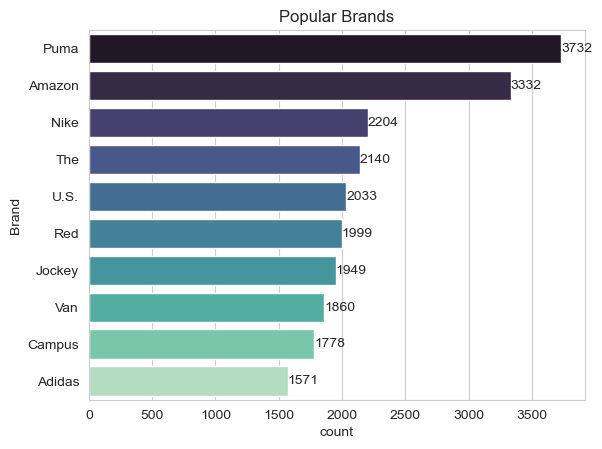

In [67]:
# most popular brand product on amazon
sns.set_style('whitegrid')
ax = sns.countplot(y = 'Brand',data = df, order = df['Brand'].value_counts(ascending=False).iloc[:10].index,palette='mako')

for i in ax.containers:
    ax.bar_label(i,)
plt.title('Popular Brands')

### Question 2

In [68]:
df_top_brands = pd.DataFrame(df['Brand'].value_counts(ascending=False).iloc[:10]).reset_index().rename({'index':'Brand','Brand':'Count'},axis='columns')
df_top_brands

,Brand,Count
0,Puma,3732
1,Amazon,3332
2,Nike,2204
3,The,2140
4,U.S.,2033
5,Red,1999
6,Jockey,1949
7,Van,1860
8,Campus,1778
9,Adidas,1571


In [69]:
df_top_brands['Brand'].values

array(['Puma', 'Amazon', 'Nike', 'The', 'U.S.', 'Red', 'Jockey', 'Van',
       'Campus', 'Adidas'], dtype=object)

In [70]:
df_top_10 = df[df['Brand'].isin(['Puma', 'Amazon', 'Nike', 'The', 'U.S.', 'Red', 'Jockey', 'Van',
       'Campus', 'Adidas'])]
df_top_10

,name,Brand,main_category,sub_category,ratings,no_of_ratings,discount_price ($USD),actual_price ($USD),net_price ($USD),discount_%_off
30,Amazon Brand - Solimo 56.5 cms Softsided Suitc...,Amazon,bags & luggage,Suitcases & Trolley Bags,4.00,59,28.79,120.00,91.21,23.99
91,Amazon Brand - Solimo ABS Hard 78 cms Trolley ...,Amazon,bags & luggage,Suitcases & Trolley Bags,4.10,25,90.69,360.00,269.31,25.19
100,Amazon Brand - Solimo Polycarbonate Hard 55 Cm...,Amazon,bags & luggage,Suitcases & Trolley Bags,3.90,38,26.33,66.00,39.67,39.89
126,Amazon Brand - Solimo ABS Hard 55 cms luggage ...,Amazon,bags & luggage,Suitcases & Trolley Bags,4.60,16,69.75,168.00,98.25,41.52
285,The Clownfish Combo of 2 Faramund Series Lugga...,The,bags & luggage,Suitcases & Trolley Bags,1.00,1,83.99,155.99,72.00,53.84
...,...,...,...,...,...,...,...,...,...,...
548267,Jockey Women Blouson Jacket,Jockey,women's clothing,Western Wear,3.90,62,0.00,22.19,22.19,0.00
548268,Amazon Brand - Symbol Women T-Shirt,Amazon,women's clothing,Western Wear,4.10,89,5.29,14.39,9.10,36.76
548286,Van Heusen Women Lounge T-Shirt - Modal Cotton...,Van,women's clothing,Western Wear,3.90,24,5.24,8.27,3.03,63.36
548316,The Souled Store |Women TSS Originals Round Ne...,The,women's clothing,Western Wear,4.70,17,6.29,17.99,11.70,34.96


In [71]:
df_top_10_groupby = df_top_10[['Brand','ratings']].groupby('Brand').mean().sort_values(by='ratings',ascending=False).reset_index()
df_top_10_groupby
# Outputting the highest average rating brand 

,Brand,ratings
0,Nike,4.15
1,Jockey,4.05
2,Van,3.98
3,Adidas,3.96
4,The,3.96
5,Amazon,3.94
6,Puma,3.94
7,U.S.,3.83
8,Campus,3.82
9,Red,3.74


(2.0, 5.0)

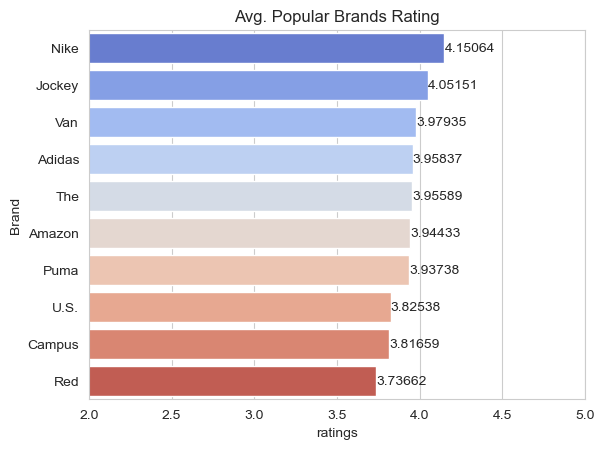

In [72]:
ax = sns.barplot(y = 'Brand',x = 'ratings',data = df_top_10_groupby,palette='coolwarm')
for i in ax.containers:
    ax.bar_label(i,)
plt.title('Avg. Popular Brands Rating')
plt.xlim([2,5])
# Graphing the highest rating average of the popular brand

### Question 3

In [73]:
df.groupby('Brand').agg({'ratings':'mean', 'no_of_ratings':'sum'}).sort_values(by='ratings',ascending=False)[:20]
# group by the brand with the average, then getting the top 15

,ratings,no_of_ratings
Brand,,
LAWRANCE,5.00,1
VIRUKSHAM,5.00,1
HIP,5.00,1
BlackFantrow,5.00,1
Radheyma,5.00,2
Evamomies,5.00,2
Black/Grey,5.00,1
Furnelift,5.00,1
Black-belt,5.00,2


### Question 4

In [74]:
df_brand = df.groupby('Brand').agg({'ratings':'mean', 'no_of_ratings':'sum'})
df_brand_2 = df_brand[df_brand['no_of_ratings'] > 10000].sort_values(by='ratings',ascending=False)[:15]
df_brand_2.reset_index()
# outputting brands that have the highest average of ratings that have # of ratings more than 10000

,Brand,ratings,no_of_ratings
0,Exo,4.88,11996
1,A&D,4.85,10132
2,DOWAN,4.83,19960
3,Luvable,4.80,19564
4,Flexible,4.80,30550
5,Cascade,4.80,157366
6,toppowersellerus,4.80,11465
7,Boveda,4.80,19534
8,GOQii,4.80,13287
9,Lansinoh,4.73,16444


(4.0, 5.0)

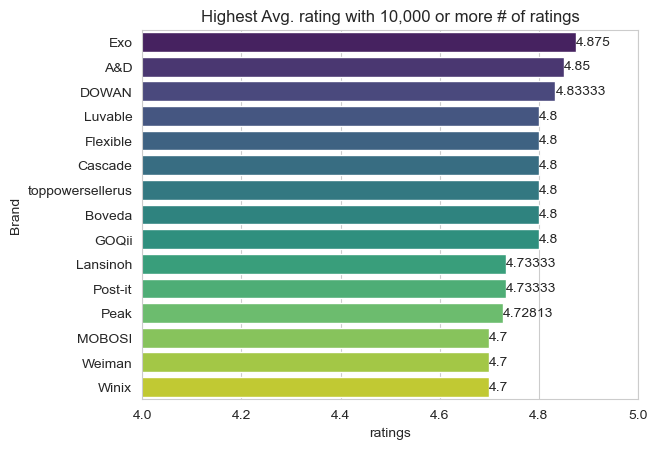

In [75]:
ax = sns.barplot(x = 'ratings',y = 'Brand',data = df_brand_2.reset_index(),
                 palette='viridis')

for i in ax.containers:
    ax.bar_label(i,)
plt.title('Highest Avg. rating with 10,000 or more # of ratings')
plt.xlim(4,5)

### Answer
1. Puma is the most popular brand with 3732 products
2. Of the top 10 most popular brand, Nike has the highest average ratings of 4.15
3. There's a lot of brands that has 5 star avg ratings that has very low # of ratings. Probably fake reviews or unpopular items.
4. With # of ratings 10,000 or more, Exo has the highest rating average of 4.875


# 3. Main and sub Categories


Questions:
1. Which main categories appeared the most in Amazon? Least?
2. What is the highest average actual price and net price of the main category? (Excluding the product named Marutivilla Insect Killer... and Clovia Women's Activewear Ankle Leggins since the price is soo way off from the realistic price from the product)
3. What is lowest average net and actual price in Sub Category?

In [76]:
df.head()

,name,Brand,main_category,sub_category,ratings,no_of_ratings,discount_price ($USD),actual_price ($USD),net_price ($USD),discount_%_off
0,Skybags Treble-FIFA 68cm Printed Polycarbonate...,Skybags,bags & luggage,Suitcases & Trolley Bags,4.50,2,87.00,174.00,87.00,50.00
2,Samsonite Polyester Hard 68 Cms Luggage- Suitc...,Samsonite,bags & luggage,Suitcases & Trolley Bags,4.00,5,146.64,225.60,78.96,65.00
3,Skybags Polycarbonate Hard 21 Cms Suitcase(_Blue),Skybags,bags & luggage,Suitcases & Trolley Bags,4.40,66,79.78,120.52,40.74,66.20
4,Skybags Game-ON FIFA 79cm Printed Polycarbonat...,Skybags,bags & luggage,Suitcases & Trolley Bags,4.30,5,82.20,208.80,126.60,39.37
6,"American Tourister Krypton Strolly 69Cm, Red P...",American,bags & luggage,Suitcases & Trolley Bags,2.80,2,69.58,150.00,80.42,46.39


### Question 1

In [77]:
df_main_gb = df[['name','main_category']].groupby('main_category').count().reset_index().rename({'name':'# of Products'},axis='columns')
df_main_gb
# groupbying by the main category with the number of products in Amazon

,main_category,# of Products
0,accessories,63305
1,appliances,25455
2,bags & luggage,3435
3,beauty & health,7344
4,car & motorbike,5337
5,grocery & gourmet foods,2856
6,home & kitchen,12590
7,"home, kitchen, pets",13
8,industrial supplies,2694
9,kids' fashion,5952


In [78]:
df_main_gb.iplot(kind='bar',x='main_category',y='# of Products',colors='blue',xTitle='Main Category',yTitle='# of Products')
# Visualizing the answer for question 1

### Question 2

In [79]:
df2 = df[(df['net_price ($USD)'] != 118799992.92) & (df['net_price ($USD)'] != 732987.62)]
# I want to get rid of the Mosquito killer item that cost hundred millions of dollars. This messes up with the average

In [80]:
df_avg_products = df2[['main_category','actual_price ($USD)','net_price ($USD)']].groupby('main_category').mean().reset_index()
df_avg_products
# getting the average Net and actaul price from the main category

,main_category,actual_price ($USD),net_price ($USD)
0,accessories,38.32,20.94
1,appliances,90.06,32.04
2,bags & luggage,43.23,25.76
3,beauty & health,12.53,5.76
4,car & motorbike,21.02,10.20
5,grocery & gourmet foods,6.88,2.74
6,home & kitchen,21.45,10.89
7,"home, kitchen, pets",52.61,10.38
8,industrial supplies,36.90,16.37
9,kids' fashion,20.95,12.39


In [81]:
df_avg_products.iplot(kind = 'bar', x='main_category', y='actual_price ($USD)',colors='red',xTitle='Main Category',yTitle=' Actual Price($USD)')

In [82]:
df_avg_products.iplot(kind = 'bar', x='main_category', y='net_price ($USD)',colors='green',xTitle='Main Category',yTitle='Net Price ($USD)')

### Question 3

In [83]:
df_box_gp = df2[['sub_category','actual_price ($USD)','net_price ($USD)']].groupby('sub_category').mean().reset_index()
df_box_gp

,sub_category,actual_price ($USD),net_price ($USD)
0,Air Conditioners,660.33,206.83
1,All Appliances,69.72,26.49
2,All Car & Motorbike Products,19.42,9.49
3,All Electronics,59.32,25.50
4,All Exercise & Fitness,27.12,15.47
...,...,...,...
107,Washing Machines,310.18,83.37
108,Watches,57.28,32.88
109,Western Wear,19.28,12.16
110,Women's Fashion,26.37,17.12


In [84]:
df_box_gp[['sub_category','actual_price ($USD)']].sort_values(by='actual_price ($USD)')

,sub_category,actual_price ($USD)
5,All Grocery & Gourmet Foods,6.16
89,Snack Foods,6.96
29,"Coffee, Tea & Beverages",7.44
105,Value Bazaar,8.14
17,Beauty & Grooming,8.85
...,...,...
107,Washing Machines,310.18
79,Refrigerators,444.20
26,Cardio Equipment,491.16
0,Air Conditioners,660.33


In [85]:
df_box_gp.iplot(x = 'sub_category',y = 'actual_price ($USD)',kind='bar',colors='purple',xTitle='Sub Categories',yTitle='Actaul_Price')
# histogram of sub category vs actual price

In [86]:
df_box_gp[['sub_category','net_price ($USD)']].sort_values(by='net_price ($USD)')
# sorting the value of the net price ascending order

,sub_category,net_price ($USD)
5,All Grocery & Gourmet Foods,2.44
105,Value Bazaar,2.59
29,"Coffee, Tea & Beverages",2.84
89,Snack Foods,2.94
47,Health & Personal Care,3.21
...,...,...
79,Refrigerators,123.44
92,Sportswear,143.19
0,Air Conditioners,206.83
26,Cardio Equipment,212.72


In [87]:
df_box_gp.iplot(x = 'sub_category',y = 'net_price ($USD)',kind='bar',xTitle='Sub Categories',yTitle='Net_Price')
# histogram of sub category vs net price

### Answer

1. Women's Clothings shows up the most on Amazon with the count of 60,684 and Home, Kitchen, Pets has the least amount of representation on the main category.
2. Without the two products mentioned before, the highest average actual price for the Main category is Appliances with $90.06 and the highest average net price of the main category is Stores.
3. The lowest average price both net and actaul for the sub category is All Grocery & Gourmet Foods

#### Note:
- I'm little bit surprised that Home, Kitchen, Pets has the lowest representation; I was expecting grocerey & gourmet to be the lowest since Amazon is usually sells objects, furnitures, and objects


# 4. Relationship with discount % off

Amazon usually gives discounts of their products. We can see what % rate is the most common. As well as any relationship with ratings.
Afterwards I'm going to use the correlation to see if there's any relationship at all with all the columns 

1. What is the most common discount % off 
2. Can you find any relationships with discount % off with ratings and # of ratings?

### Question 1

In [88]:
df.columns

Index(['name', 'Brand', 'main_category', 'sub_category', 'ratings',
       'no_of_ratings', 'discount_price ($USD)', 'actual_price ($USD)',
       'net_price ($USD)', 'discount_%_off'],
      dtype='object')

In [89]:
df['discount_%_off'].iplot(kind = 'hist',bins=100,xTitle = 'discount % off',title = 'Popular discount % off', yTitle = 'count')

### Question 2

<Axes: xlabel='discount_%_off', ylabel='no_of_ratings'>

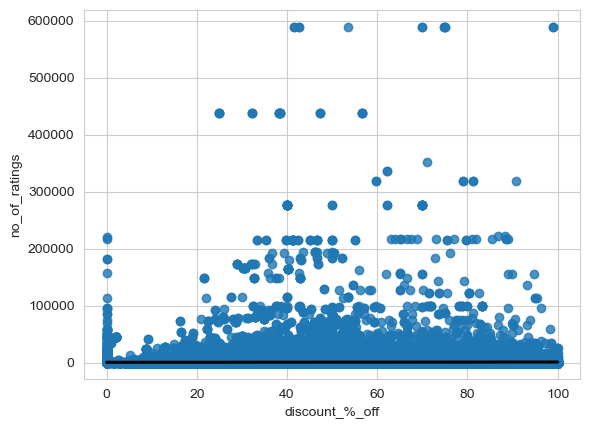

In [90]:
sns.regplot(x = 'discount_%_off', y = 'no_of_ratings', data = df,line_kws={"color": "black"})
# There's no 

<Axes: xlabel='discount_%_off', ylabel='ratings'>

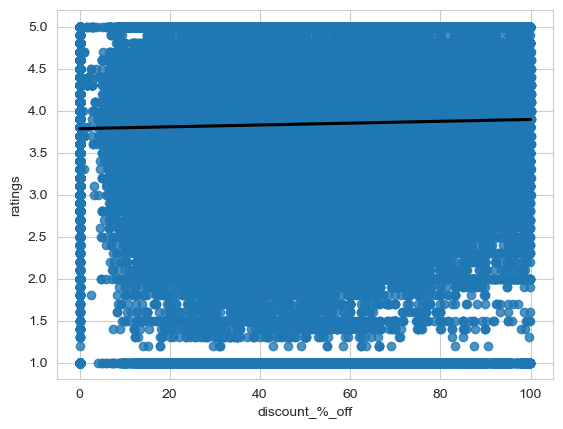

In [91]:
sns.regplot(x = 'discount_%_off', y = 'ratings', data = df,line_kws={"color": "black"})
# There is no relationship between ratings and discount % off
# It seems we have a positive slope, definitely a stronger relationship than the # of ratings

In [92]:
df.corr()

,ratings,no_of_ratings,discount_price ($USD),actual_price ($USD),net_price ($USD),discount_%_off
ratings,1.00,0.03,0.05,-0.00,-0.00,0.04
no_of_ratings,0.03,1.00,0.01,-0.00,-0.00,0.01
discount_price ($USD),0.05,0.01,1.00,0.00,-0.00,0.21
actual_price ($USD),-0.00,-0.00,0.00,1.00,1.00,-0.00
net_price ($USD),-0.00,-0.00,-0.00,1.00,1.00,-0.00
discount_%_off,0.04,0.01,0.21,-0.00,-0.00,1.00


<Axes: >

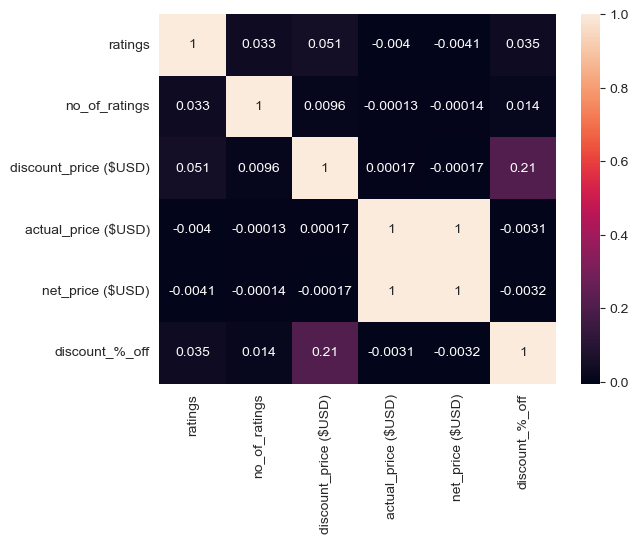

In [93]:
sns.heatmap(df.corr(),annot=True)

### Answers
1. The most common discount % on amazon is between -1 and 1%. Most likely those product doesn't offer discounts.
    - Aside of 0% discount, 49-50.99% discount is the most common
2. For discount % vs # of ratings, they have no relationship with one another, the correletion proves that with 0.014
    For the discount % vs # of ratings it's still have little to no relationship with each other with the correlation of 0.035

# Insights and Conclusion


1. Puma, Amazon, and Nike are the most popular brand on Amazon
2. So far, it's hard to determine a relationship with discount % and ratings. 
3. People buy product that are in the range between $11.00 - $12.99
4. The top 2 expensive items is fake
5. Exo brand has the best average ratings with high # of review 
6. 5 star products shouldn't be trusted since no one buys them.
7. Amazon most popular main category is Accessories 
8. Of the top 10 brands, Nike has the best avg. ratings
9. It's hard to determine if the discount % helps with the ratings or purchases. We can use some machine learning or dig deeper to solve this issue

## Reference 
'https://www.kaggle.com/datasets/lokeshparab/amazon-products-dataset/data'